In [246]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns #for plotting
import warnings
from sklearn.cluster import KMeans
import warnings
from sklearn.ensemble import RandomForestClassifier #for the model
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_graphviz #plot tree
from sklearn.metrics import roc_curve, auc #for model evaluation
from sklearn.metrics import classification_report #for model evaluation
from sklearn.metrics import confusion_matrix #for model evaluation
from sklearn.model_selection import train_test_split #for data splitting
from sklearn.feature_selection import RFE
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn import svm
import statsmodels.api as sm
import eli5 #for purmutation importance
from eli5.sklearn import PermutationImportance
import shap #for SHAP values
from pdpbox import pdp, info_plots #for partial plots
np.random.seed(123) #ensure reproducibility
pd.options.mode.chained_assignment = None  #hide any pandas warnings
import scipy.stats as stats
import pylab
%matplotlib inline
pd.pandas.set_option('display.max_columns',None)
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)


In [16]:
dt = pd.read_csv("heart.csv")

In [17]:
dt.head(10)

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,63,1,3,145,233,1,0,150,0,2.3,0,0,1,1
1,37,1,2,130,250,0,1,187,0,3.5,0,0,2,1
2,41,0,1,130,204,0,0,172,0,1.4,2,0,2,1
3,56,1,1,120,236,0,1,178,0,0.8,2,0,2,1
4,57,0,0,120,354,0,1,163,1,0.6,2,0,2,1
5,57,1,0,140,192,0,1,148,0,0.4,1,0,1,1
6,56,0,1,140,294,0,0,153,0,1.3,1,0,2,1
7,44,1,1,120,263,0,1,173,0,0.0,2,0,3,1
8,52,1,2,172,199,1,1,162,0,0.5,2,0,3,1
9,57,1,2,150,168,0,1,174,0,1.6,2,0,2,1


,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
298,57,0,0,140,241,0,1,123,1,0.2,1,0,3,0
299,45,1,3,110,264,0,1,132,0,1.2,1,0,3,0
300,68,1,0,144,193,1,1,141,0,3.4,1,2,3,0
301,57,1,0,130,131,0,1,115,1,1.2,1,1,3,0
302,57,0,1,130,236,0,0,174,0,0.0,1,1,2,0


In [19]:
dt.columns

Index(['age', 'sex', 'cp', 'trestbps', 'chol', 'fbs', 'restecg', 'thalach',
       'exang', 'oldpeak', 'slope', 'ca', 'thal', 'target'],
      dtype='object')

In [20]:
dt.columns = ['age', 'gender', 'chest_pain_type', 'resting_blood_pressure', 'cholesterol', 'fasting_blood_sugar', 'rest_ecg', 'max_heart_rate_achieved',
       'exercise_induced_angina', 'st_depression', 'st_slope', 'num_major_vessels', 'thalassemia', 'target']

In [21]:
dt['gender'][dt['gender'] == 0] = 'female'
dt['gender'][dt['gender'] == 1] = 'male'

dt['chest_pain_type'][dt['chest_pain_type'] == 1] = 'typical angina'
dt['chest_pain_type'][dt['chest_pain_type'] == 2] = 'atypical angina'
dt['chest_pain_type'][dt['chest_pain_type'] == 3] = 'non-anginal pain'
dt['chest_pain_type'][dt['chest_pain_type'] == 4] = 'asymptomatic'

dt['fasting_blood_sugar'][dt['fasting_blood_sugar'] == 0] = 'lower than 120mg/ml'
dt['fasting_blood_sugar'][dt['fasting_blood_sugar'] == 1] = 'greater than 120mg/ml'

dt['rest_ecg'][dt['rest_ecg'] == 0] = 'normal'
dt['rest_ecg'][dt['rest_ecg'] == 1] = 'ST-T wave abnormality'
dt['rest_ecg'][dt['rest_ecg'] == 2] = 'left ventricular hypertrophy'

dt['exercise_induced_angina'][dt['exercise_induced_angina'] == 0] = 'no'
dt['exercise_induced_angina'][dt['exercise_induced_angina'] == 1] = 'yes'

dt['st_slope'][dt['st_slope'] == 1] = 'upsloping'
dt['st_slope'][dt['st_slope'] == 2] = 'flat'
dt['st_slope'][dt['st_slope'] == 3] = 'downsloping'

dt['thalassemia'][dt['thalassemia'] == 1] = 'normal'
dt['thalassemia'][dt['thalassemia'] == 2] = 'fixed defect'
dt['thalassemia'][dt['thalassemia'] == 3] = 'reversable defect'

In [22]:
dt.dtypes

age                          int64
gender                      object
chest_pain_type             object
resting_blood_pressure       int64
cholesterol                  int64
fasting_blood_sugar         object
rest_ecg                    object
max_heart_rate_achieved      int64
exercise_induced_angina     object
st_depression              float64
st_slope                    object
num_major_vessels            int64
thalassemia                 object
target                       int64
dtype: object

# DATA CLEANSING

In [24]:
dt.isnull().sum()

age                        0
gender                     0
chest_pain_type            0
resting_blood_pressure     0
cholesterol                0
fasting_blood_sugar        0
rest_ecg                   0
max_heart_rate_achieved    0
exercise_induced_angina    0
st_depression              0
st_slope                   0
num_major_vessels          0
thalassemia                0
target                     0
dtype: int64

### Droping Null values because Null values are very less as compared to data size

In [25]:
dt=dt.dropna()

# DATA INSIGHTS

In [26]:
dt.age.unique()

array([63, 37, 41, 56, 57, 44, 52, 54, 48, 49, 64, 58, 50, 66, 43, 69, 59,
       42, 61, 40, 71, 51, 65, 53, 46, 45, 39, 47, 62, 34, 35, 29, 55, 60,
       67, 68, 74, 76, 70, 38, 77], dtype=int64)

In [27]:
dt.age.value_counts()

58    19
57    17
54    16
59    14
52    13
51    12
62    11
60    11
44    11
56    11
64    10
41    10
63     9
67     9
65     8
43     8
45     8
55     8
42     8
61     8
53     8
46     7
48     7
66     7
50     7
49     5
47     5
70     4
39     4
35     4
68     4
38     3
71     3
40     3
69     3
34     2
37     2
29     1
74     1
76     1
77     1
Name: age, dtype: int64

In [28]:
dt.gender.unique()

array(['male', 'female'], dtype=object)

In [29]:
dt.gender.value_counts()

male      207
female     96
Name: gender, dtype: int64

In [30]:
dt.chest_pain_type.unique()

array(['non-anginal pain', 'atypical angina', 'typical angina', 0],
      dtype=object)

In [31]:
dt.chest_pain_type.value_counts()

0                   143
atypical angina      87
typical angina       50
non-anginal pain     23
Name: chest_pain_type, dtype: int64

In [32]:
dt.resting_blood_pressure.unique()

array([145, 130, 120, 140, 172, 150, 110, 135, 160, 105, 125, 142, 155,
       104, 138, 128, 108, 134, 122, 115, 118, 100, 124,  94, 112, 102,
       152, 101, 132, 148, 178, 129, 180, 136, 126, 106, 156, 170, 146,
       117, 200, 165, 174, 192, 144, 123, 154, 114, 164], dtype=int64)

In [33]:
dt.resting_blood_pressure.value_counts()

120    37
130    36
140    32
110    19
150    17
138    13
128    12
160    11
125    11
112     9
132     8
118     7
124     6
135     6
108     6
152     5
134     5
145     5
122     4
170     4
100     4
105     3
126     3
115     3
180     3
136     3
142     3
102     2
148     2
178     2
94      2
144     2
146     2
200     1
114     1
154     1
123     1
192     1
174     1
165     1
104     1
117     1
101     1
156     1
106     1
155     1
129     1
172     1
164     1
Name: resting_blood_pressure, dtype: int64

In [34]:
dt.cholesterol.unique()

array([233, 250, 204, 236, 354, 192, 294, 263, 199, 168, 239, 275, 266,
       211, 283, 219, 340, 226, 247, 234, 243, 302, 212, 175, 417, 197,
       198, 177, 273, 213, 304, 232, 269, 360, 308, 245, 208, 264, 321,
       325, 235, 257, 216, 256, 231, 141, 252, 201, 222, 260, 182, 303,
       265, 309, 186, 203, 183, 220, 209, 258, 227, 261, 221, 205, 240,
       318, 298, 564, 277, 214, 248, 255, 207, 223, 288, 160, 394, 315,
       246, 244, 270, 195, 196, 254, 126, 313, 262, 215, 193, 271, 268,
       267, 210, 295, 306, 178, 242, 180, 228, 149, 278, 253, 342, 157,
       286, 229, 284, 224, 206, 167, 230, 335, 276, 353, 225, 330, 290,
       172, 305, 188, 282, 185, 326, 274, 164, 307, 249, 341, 407, 217,
       174, 281, 289, 322, 299, 300, 293, 184, 409, 259, 200, 327, 237,
       218, 319, 166, 311, 169, 187, 176, 241, 131], dtype=int64)

In [35]:
dt.cholesterol.value_counts()

204    6
197    6
234    6
269    5
254    5
      ..
284    1
224    1
167    1
276    1
131    1
Name: cholesterol, Length: 152, dtype: int64

In [36]:
dt.fasting_blood_sugar.unique()

array(['greater than 120mg/ml', 'lower than 120mg/ml'], dtype=object)

In [37]:
dt.fasting_blood_sugar.value_counts()

lower than 120mg/ml      258
greater than 120mg/ml     45
Name: fasting_blood_sugar, dtype: int64

In [38]:
dt.rest_ecg.unique()

array(['normal', 'ST-T wave abnormality', 'left ventricular hypertrophy'],
      dtype=object)

In [39]:
dt.rest_ecg.value_counts()

ST-T wave abnormality           152
normal                          147
left ventricular hypertrophy      4
Name: rest_ecg, dtype: int64

In [40]:
dt.max_heart_rate_achieved.value_counts()

162    11
160     9
163     9
152     8
173     8
       ..
202     1
184     1
121     1
192     1
90      1
Name: max_heart_rate_achieved, Length: 91, dtype: int64

In [41]:
dt.max_heart_rate_achieved.unique()

array([150, 187, 172, 178, 163, 148, 153, 173, 162, 174, 160, 139, 171,
       144, 158, 114, 151, 161, 179, 137, 157, 123, 152, 168, 140, 188,
       125, 170, 165, 142, 180, 143, 182, 156, 115, 149, 146, 175, 186,
       185, 159, 130, 190, 132, 147, 154, 202, 166, 164, 184, 122, 169,
       138, 111, 145, 194, 131, 133, 155, 167, 192, 121,  96, 126, 105,
       181, 116, 108, 129, 120, 112, 128, 109, 113,  99, 177, 141, 136,
        97, 127, 103, 124,  88, 195, 106,  95, 117,  71, 118, 134,  90],
      dtype=int64)

In [42]:
dt.exercise_induced_angina.unique()

array(['no', 'yes'], dtype=object)

In [43]:
dt.exercise_induced_angina.value_counts()

no     204
yes     99
Name: exercise_induced_angina, dtype: int64

In [44]:
dt.st_depression.value_counts()

0.0    99
1.2    17
1.0    14
0.6    14
1.4    13
0.8    13
0.2    12
1.6    11
1.8    10
0.4     9
2.0     9
0.1     7
2.8     6
2.6     6
1.5     5
3.0     5
1.9     5
0.5     5
3.6     4
2.2     4
2.4     3
0.9     3
3.4     3
4.0     3
0.3     3
2.3     2
3.2     2
2.5     2
4.2     2
1.1     2
3.1     1
0.7     1
3.5     1
6.2     1
1.3     1
5.6     1
2.9     1
2.1     1
3.8     1
4.4     1
Name: st_depression, dtype: int64

In [45]:
dt.st_depression.value_counts()

0.0    99
1.2    17
1.0    14
0.6    14
1.4    13
0.8    13
0.2    12
1.6    11
1.8    10
0.4     9
2.0     9
0.1     7
2.8     6
2.6     6
1.5     5
3.0     5
1.9     5
0.5     5
3.6     4
2.2     4
2.4     3
0.9     3
3.4     3
4.0     3
0.3     3
2.3     2
3.2     2
2.5     2
4.2     2
1.1     2
3.1     1
0.7     1
3.5     1
6.2     1
1.3     1
5.6     1
2.9     1
2.1     1
3.8     1
4.4     1
Name: st_depression, dtype: int64

In [46]:
dt.st_slope.unique()

array([0, 'flat', 'upsloping'], dtype=object)

In [47]:
dt.st_slope.value_counts()

flat         142
upsloping    140
0             21
Name: st_slope, dtype: int64

In [48]:
dt.num_major_vessels.value_counts()

0    175
1     65
2     38
3     20
4      5
Name: num_major_vessels, dtype: int64

In [49]:
dt.num_major_vessels.unique()

array([0, 2, 1, 3, 4], dtype=int64)

In [50]:
dt.thalassemia.unique()

array(['normal', 'fixed defect', 'reversable defect', 0], dtype=object)

In [51]:
dt.thalassemia.value_counts()

fixed defect         166
reversable defect    117
normal                18
0                      2
Name: thalassemia, dtype: int64

  0%|                                                                                         | 0/1699 [00:00<…

DataPrep Report
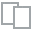
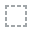
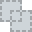
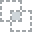
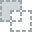
...
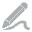
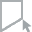
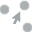
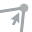
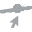

In [52]:
from dataprep.datasets import load_dataset
from dataprep.eda import create_report
#df = load_dataset("titanic")
create_report(dt)

# CHECK FOR OUTLIERS

{'whiskers': [<matplotlib.lines.Line2D at 0x157106f29c8>,
 'caps': [<matplotlib.lines.Line2D at 0x157106f2e88>,
 'boxes': [<matplotlib.lines.Line2D at 0x157106db688>],
 'medians': [<matplotlib.lines.Line2D at 0x157106f27c8>],
 'fliers': [<matplotlib.lines.Line2D at 0x157106db4c8>],
 'means': []}

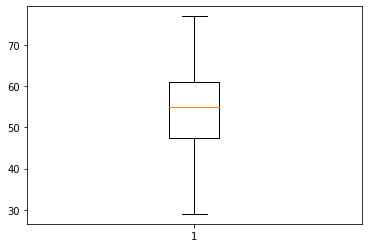

In [90]:
plt.boxplot(dt.age)

{'whiskers': [<matplotlib.lines.Line2D at 0x157101a1e88>,
 'caps': [<matplotlib.lines.Line2D at 0x157101a2588>,
 'boxes': [<matplotlib.lines.Line2D at 0x157101a1948>],
 'medians': [<matplotlib.lines.Line2D at 0x157101a1d48>],
 'fliers': [<matplotlib.lines.Line2D at 0x157101a1f88>],
 'means': []}

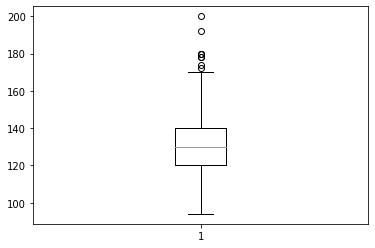

In [91]:
plt.boxplot(dt.resting_blood_pressure)

{'whiskers': [<matplotlib.lines.Line2D at 0x1571069d448>,
 'caps': [<matplotlib.lines.Line2D at 0x1571069d388>,
 'boxes': [<matplotlib.lines.Line2D at 0x157106cbec8>],
 'medians': [<matplotlib.lines.Line2D at 0x1571069d288>],
 'fliers': [<matplotlib.lines.Line2D at 0x1571069d548>],
 'means': []}

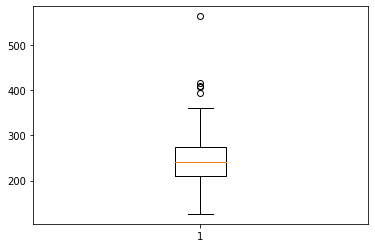

In [92]:
plt.boxplot(dt.cholesterol)

{'whiskers': [<matplotlib.lines.Line2D at 0x15711622dc8>,
 'caps': [<matplotlib.lines.Line2D at 0x15711622f88>,
 'boxes': [<matplotlib.lines.Line2D at 0x15711622888>],
 'medians': [<matplotlib.lines.Line2D at 0x15711622c88>],
 'fliers': [<matplotlib.lines.Line2D at 0x15711622ec8>],
 'means': []}

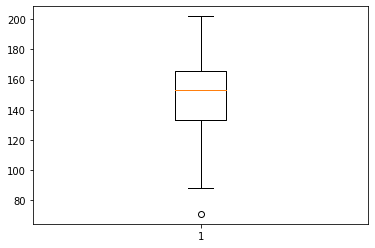

In [93]:
plt.boxplot(dt.max_heart_rate_achieved)

{'whiskers': [<matplotlib.lines.Line2D at 0x1571020f1c8>,
 'caps': [<matplotlib.lines.Line2D at 0x1571020f6c8>,
 'boxes': [<matplotlib.lines.Line2D at 0x157112b3e48>],
 'medians': [<matplotlib.lines.Line2D at 0x1571020fc88>],
 'fliers': [<matplotlib.lines.Line2D at 0x1571020fcc8>],
 'means': []}

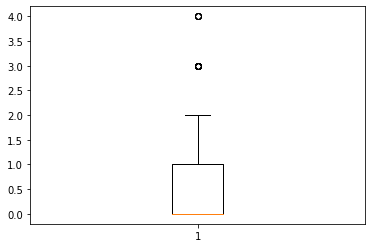

In [94]:
plt.boxplot(dt.num_major_vessels)

# STATISTICAL EDA

In [60]:
dt.mean()

age                         54.366337
resting_blood_pressure     131.623762
cholesterol                246.264026
max_heart_rate_achieved    149.646865
st_depression                1.039604
num_major_vessels            0.729373
target                       0.544554
dtype: float64

In [61]:
dt.median()

age                         55.0
resting_blood_pressure     130.0
cholesterol                240.0
max_heart_rate_achieved    153.0
st_depression                0.8
num_major_vessels            0.0
target                       1.0
dtype: float64

In [62]:
dt.mode()

,age,gender,chest_pain_type,resting_blood_pressure,cholesterol,fasting_blood_sugar,rest_ecg,max_heart_rate_achieved,exercise_induced_angina,st_depression,st_slope,num_major_vessels,thalassemia,target
0,58.0,male,0,120.0,197,lower than 120mg/ml,ST-T wave abnormality,162.0,no,0.0,flat,0.0,fixed defect,1.0
1,NaN,NaN,NaN,NaN,204,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,234,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [63]:
dt.describe()

,age,resting_blood_pressure,cholesterol,max_heart_rate_achieved,st_depression,num_major_vessels,target
count,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000
mean,54.366337,131.623762,246.264026,149.646865,1.039604,0.729373,0.544554
std,9.082101,17.538143,51.830751,22.905161,1.161075,1.022606,0.498835
min,29.000000,94.000000,126.000000,71.000000,0.000000,0.000000,0.000000
25%,47.500000,120.000000,211.000000,133.500000,0.000000,0.000000,0.000000
50%,55.000000,130.000000,240.000000,153.000000,0.800000,0.000000,1.000000
75%,61.000000,140.000000,274.500000,166.000000,1.600000,1.000000,1.000000
max,77.000000,200.000000,564.000000,202.000000,6.200000,4.000000,1.000000


In [64]:
dt.skew()

age                       -0.202463
resting_blood_pressure     0.713768
cholesterol                1.143401
max_heart_rate_achieved   -0.537410
st_depression              1.269720
num_major_vessels          1.310422
target                    -0.179821
dtype: float64

In [65]:
dt.corr()

,age,resting_blood_pressure,cholesterol,max_heart_rate_achieved,st_depression,num_major_vessels,target
age,1.000000,0.279351,0.213678,-0.398522,0.210013,0.276326,-0.225439
resting_blood_pressure,0.279351,1.000000,0.123174,-0.046698,0.193216,0.101389,-0.144931
cholesterol,0.213678,0.123174,1.000000,-0.009940,0.053952,0.070511,-0.085239
max_heart_rate_achieved,-0.398522,-0.046698,-0.009940,1.000000,-0.344187,-0.213177,0.421741
st_depression,0.210013,0.193216,0.053952,-0.344187,1.000000,0.222682,-0.430696
num_major_vessels,0.276326,0.101389,0.070511,-0.213177,0.222682,1.000000,-0.391724
target,-0.225439,-0.144931,-0.085239,0.421741,-0.430696,-0.391724,1.000000


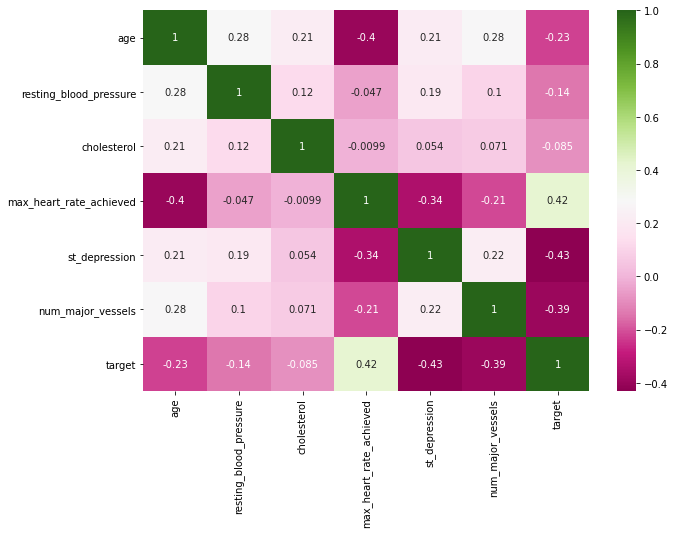

In [96]:
dataplot = sns.heatmap(dt.corr(),cmap = "PiYG",annot = True)
plt.rcParams['figure.figsize'] = [10,10]

## Heart Diseases Ratio in Dataset
Blue Graph indicate no heart desease and Orange Graph show Heart desease

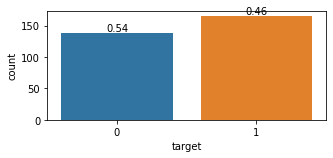

In [101]:
def plotTarget():
    sns.countplot(x='target', data=dt, ax=ax)
    for i, p in enumerate(ax.patches):
        count=dt['target'].value_counts().values[i]
        x=p.get_x()+ p.get_width() /2.
        y=p.get_height() + 3
        label='{:1.2f}'.format(count / float(dt.shape[0]))
        ax.text(x, y,label, ha='center')
        
fig_target,ax=plt.subplots(nrows=1, ncols=1, figsize=(5, 2))
plotTarget()

## Select Age as most dependent data on label
Disease Probability Bar Plot

In [133]:
def plotAge():
    facet_grid = sns.FacetGrid(dt, hue='target')
    facet_grid.map(sns.kdeplot, "age", shade=True, ax=axes[0])
    legend_labels = ['disease false', 'disease true']
    #for t, l in zip(axes[0].get_legend().texts, legend_labels):
        #t.set_text(l)
        
    axes[0].set(xlabel='age', ylabel='density')

    avg = dt[["age", "target"]].groupby(['age'], as_index=False).mean()
    sns.barplot(x='age', y='target', data=avg, ax=axes[1])
    axes[1].set(xlabel='age', ylabel='disease probability')

    plt.clf()

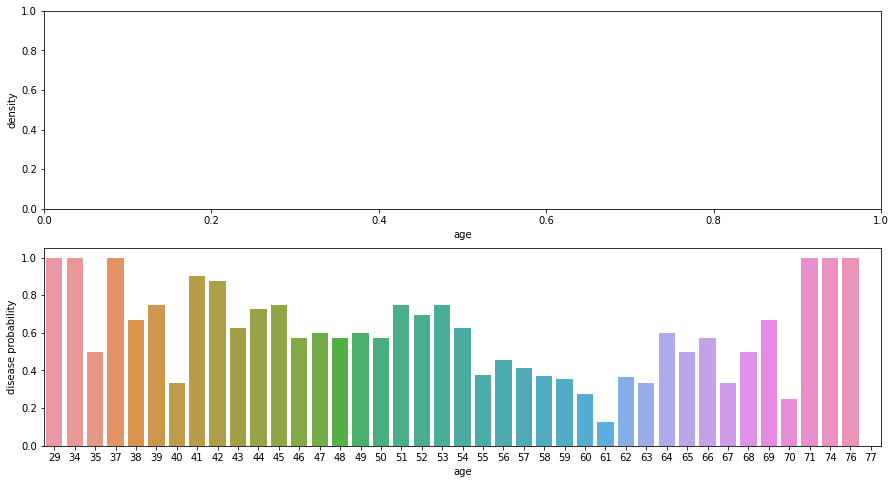

<Figure size 216x216 with 0 Axes>

In [134]:
fig_age, axes = plt.subplots(nrows=2, ncols=1, figsize=(15, 8))

plotAge()

## Ploting Function For Categorical Data " Chest Pain" && "Thalassemia"
Ploting Function For Continoius Data

In [150]:
category=[('gender',['female','male']),('chest_pain_type',['typical angina','atypical angina','non-anginal pain','asymptomatic']),('fasting_blood_sugar',['lower than 120mg/ml','greater than 120mg/ml']),('rest_ecg',['normal','ST-T wave abnormality','left ventricular hypertrophy']),('exercise_induced_angina',['no','yes']),('st_slope',['upsloping','flat','downsloping']),('thalassemia',['fixed','normal','reversable'])]
continuous = [('resting_blood_pressure'),('cholesterol'),('max_heart_rate_achieved'),('st_depression'),('num_major_vessels')]

        
def plotCategorial(attribute, labels, ax_index):
    sns.countplot(x=attribute, data=dt, ax=axes[ax_index][0])
    sns.countplot(x='target', hue=attribute, data=dt, ax=axes[ax_index][1])
    avg = dt[[attribute, 'target']].groupby([attribute], as_index=False).mean()
    sns.barplot(x=attribute, y='target', hue=attribute, data=avg, ax=axes[ax_index][2])
    
    for t, l in zip(axes[ax_index][1].get_legend().texts, labels):
        t.set_text(l)
    for t, l in zip(axes[ax_index][2].get_legend().texts, labels):
        t.set_text(l)


def plotContinuous(attribute, xlabel, ax_index):
    sns.distplot(dt[[attribute]], ax=axes[ax_index][0])
    axes[ax_index][0].set(xlabel=xlabel, ylabel='density')
    sns.violinplot(x='target', y=attribute, data=dt, ax=axes[ax_index][1])
    
    
def plotGrid(isCategorial):
    if isCategorial:
        [plotCategorial(x[0], x[1], i) for i, x in enumerate(category)] 
    else:
        [plotContinuous(x[0], x[1], i) for i, x in enumerate(continuous)]

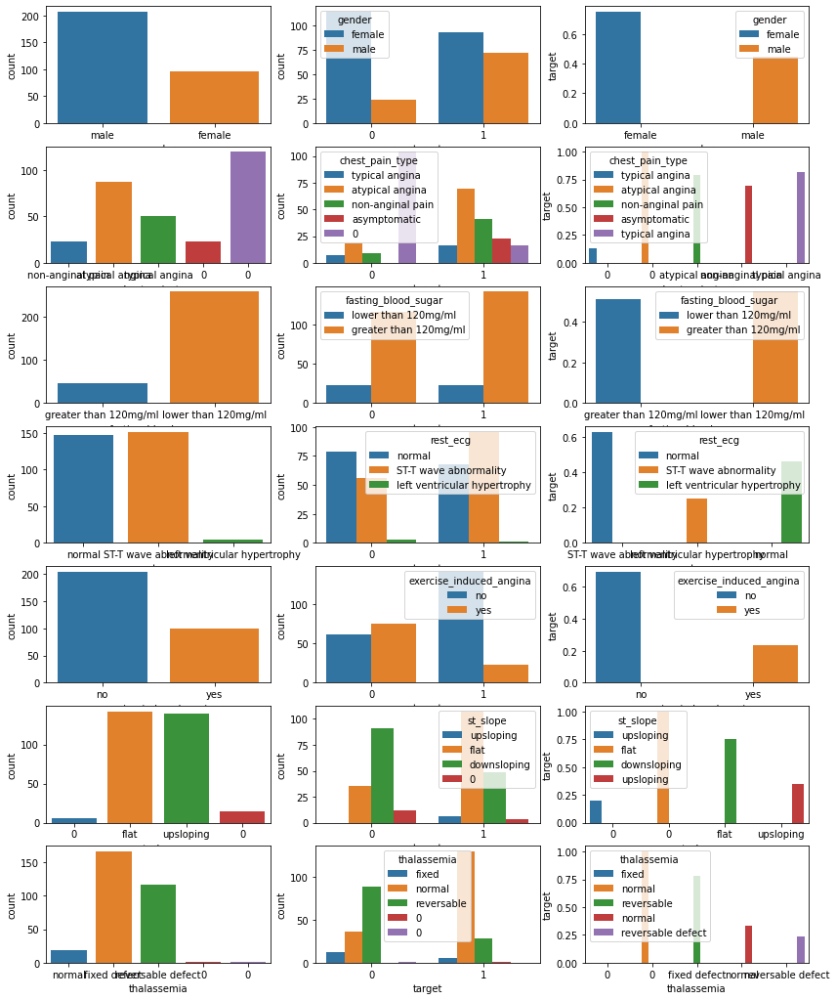

In [148]:
fig_categorial,axes=plt.subplots(nrows=len(category), ncols=3, figsize=(14, 18))
plotGrid(isCategorial=True)

<AxesSubplot:xlabel='age', ylabel='Density'>

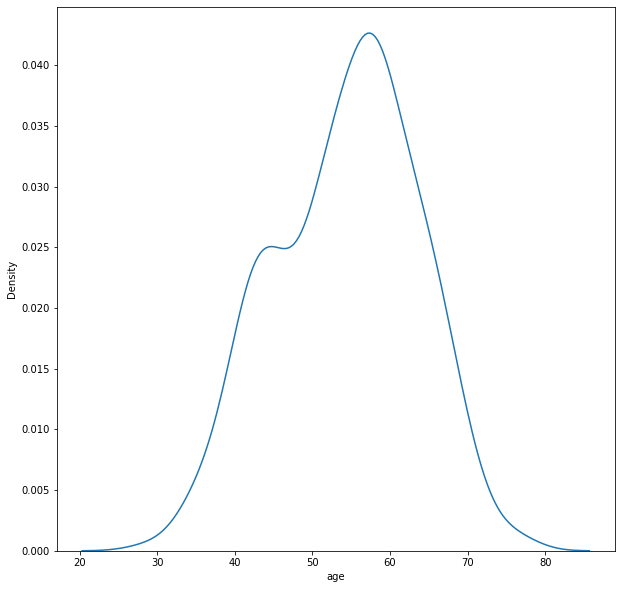

In [155]:
sns.kdeplot(dt.age)

((array([-2.83587732, -2.53977915, -2.3721488 , -2.25270611, -2.15873923,
         -2.08068092, -2.01355914, -1.95444546, -1.9014639 , -1.85333753,
         -1.80915637, -1.76824812, -1.73010145, -1.69431802, -1.6605812 ,
         -1.62863502, -1.59826945, -1.56930992, -1.54160973, -1.51504433,
         -1.48950705, -1.46490582, -1.44116054, -1.41820113, -1.39596588,
         -1.37440015, -1.35345534, -1.333088  , -1.31325913, -1.29393359,
         -1.27507957, -1.25666822, -1.23867328, -1.22107074, -1.20383863,
         -1.18695677, -1.17040658, -1.1541709 , -1.1382339 , -1.12258087,
         -1.10719816, -1.09207308, -1.07719379, -1.06254924, -1.04812909,
         -1.03392365, -1.01992386, -1.00612116, -0.99250752, -0.97907539,
         -0.96581763, -0.95272748, -0.93979859, -0.92702491, -0.91440073,
         -0.90192062, -0.88957943, -0.87737226, -0.86529445, -0.85334157,
         -0.84150938, -0.82979385, -0.81819112, -0.8066975 , -0.79530947,
         -0.78402367, -0.77283685, -0.

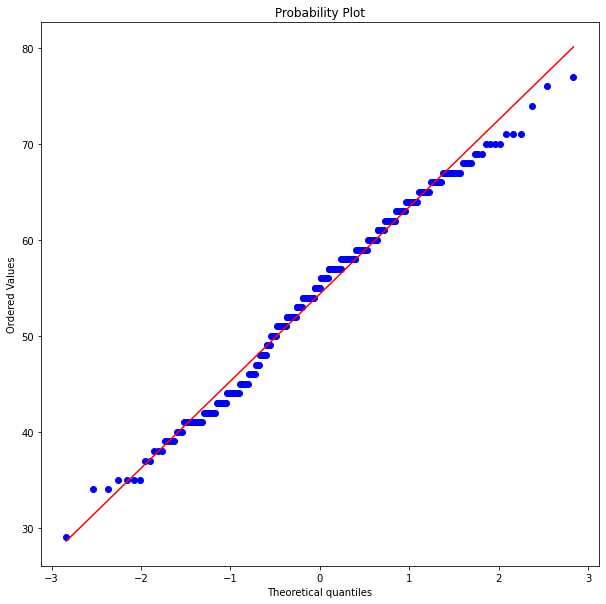

In [156]:
stats.probplot(dt.age,plot=pylab)

<AxesSubplot:xlabel='max_heart_rate_achieved', ylabel='Density'>

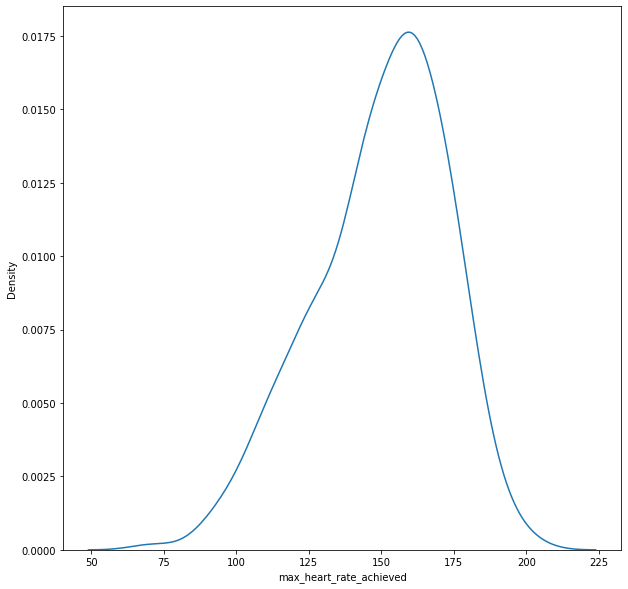

In [157]:
sns.kdeplot(dt.max_heart_rate_achieved)

((array([-2.83587732, -2.53977915, -2.3721488 , -2.25270611, -2.15873923,
         -2.08068092, -2.01355914, -1.95444546, -1.9014639 , -1.85333753,
         -1.80915637, -1.76824812, -1.73010145, -1.69431802, -1.6605812 ,
         -1.62863502, -1.59826945, -1.56930992, -1.54160973, -1.51504433,
         -1.48950705, -1.46490582, -1.44116054, -1.41820113, -1.39596588,
         -1.37440015, -1.35345534, -1.333088  , -1.31325913, -1.29393359,
         -1.27507957, -1.25666822, -1.23867328, -1.22107074, -1.20383863,
         -1.18695677, -1.17040658, -1.1541709 , -1.1382339 , -1.12258087,
         -1.10719816, -1.09207308, -1.07719379, -1.06254924, -1.04812909,
         -1.03392365, -1.01992386, -1.00612116, -0.99250752, -0.97907539,
         -0.96581763, -0.95272748, -0.93979859, -0.92702491, -0.91440073,
         -0.90192062, -0.88957943, -0.87737226, -0.86529445, -0.85334157,
         -0.84150938, -0.82979385, -0.81819112, -0.8066975 , -0.79530947,
         -0.78402367, -0.77283685, -0.

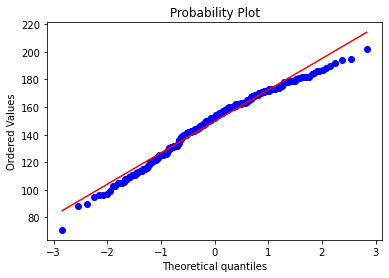

In [16]:
stats.probplot(dt.max_heart_rate_achieved,plot=pylab)

In [158]:
def normality(data,feature):
    mlp.figure(figsize=(10,5))
    mlp.subplot(1,2,1)
    sns.kdeplot(data[feature])
    mlp.subplot(1,2,2)
    stats.probplot(data[feature],plot=pylab)
    mlp.show()

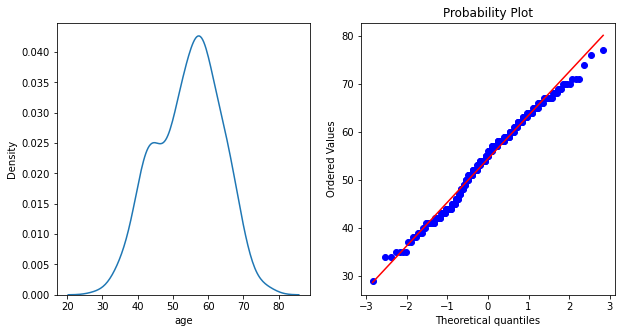

In [159]:
normality(dt,'age')

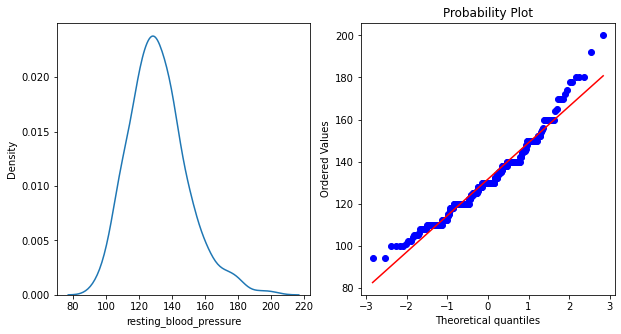

In [160]:
normality(dt,'resting_blood_pressure')

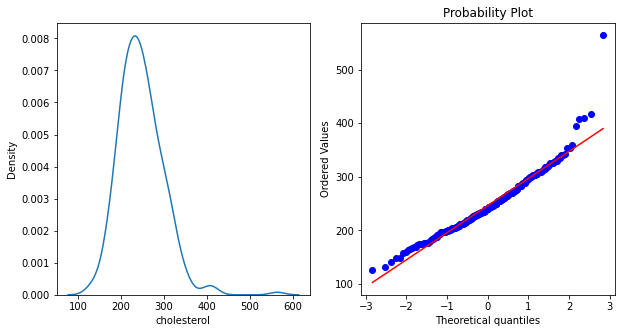

In [161]:
normality(dt,'cholesterol')

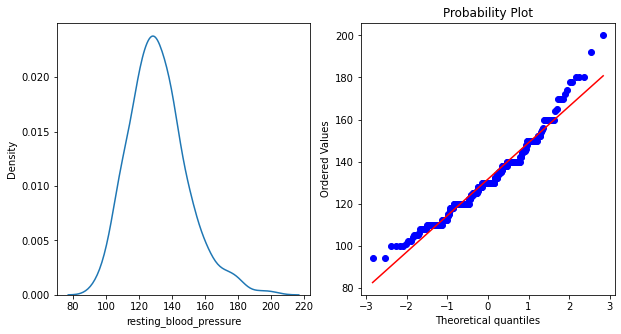

In [162]:
normality(dt,'resting_blood_pressure')

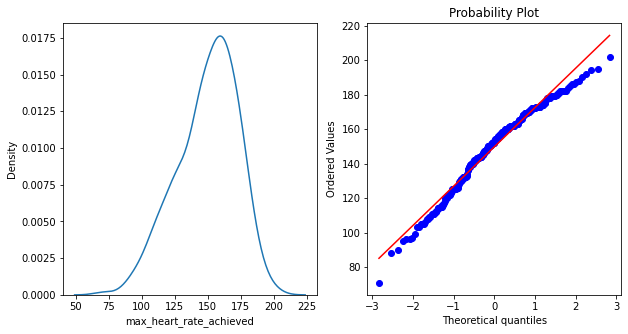

In [163]:
normality(dt,'max_heart_rate_achieved')

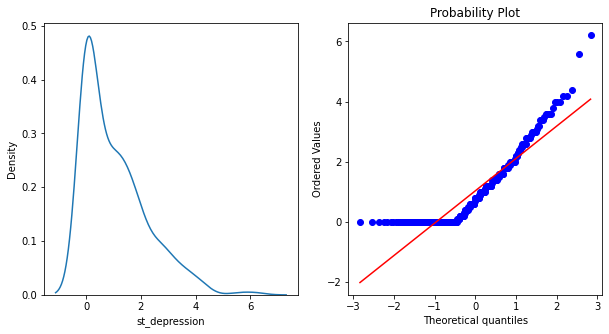

In [164]:
normality(dt,'st_depression')

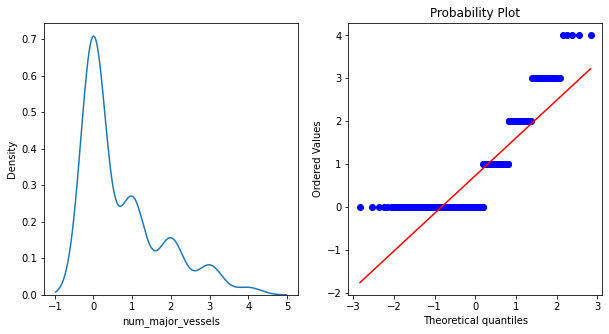

In [165]:
normality(dt,'num_major_vessels')

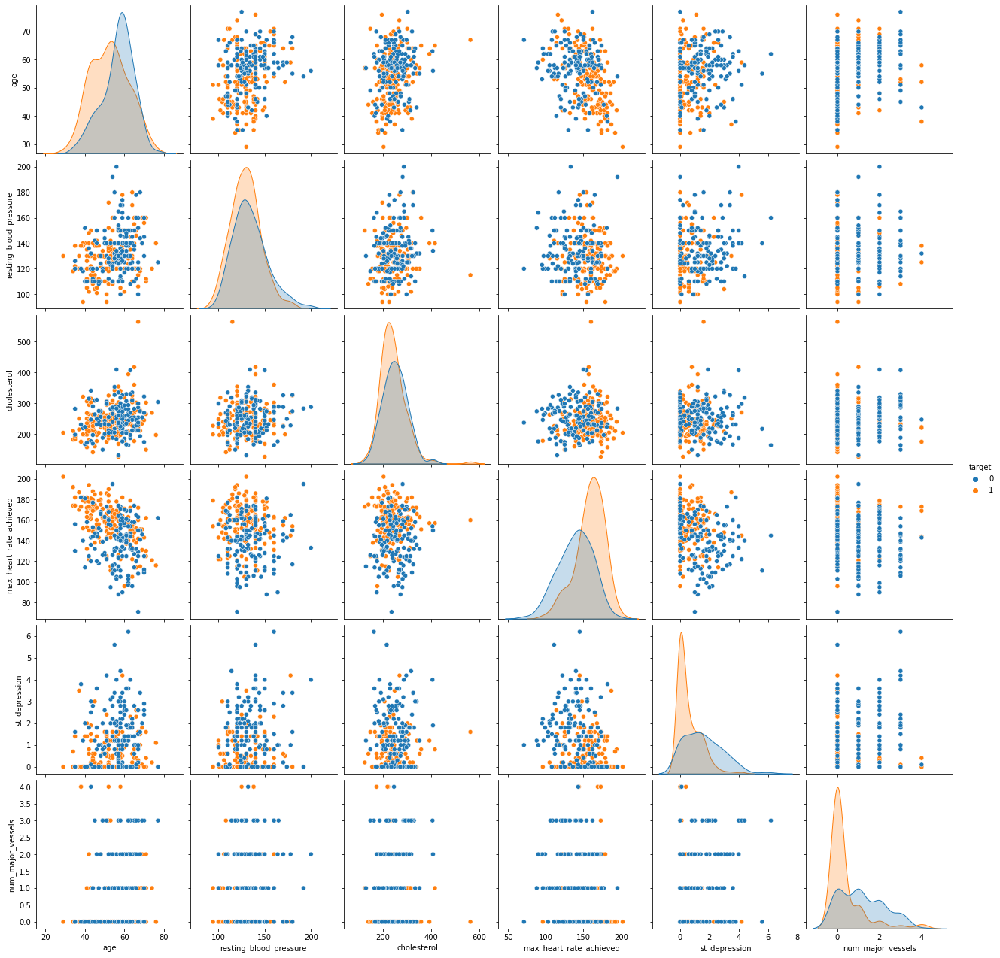

In [166]:
sns.pairplot(dt,hue="target",size = 3)

# TRANSFORMATIONS(log, sqrt, reciprocal, boxcox)

In [168]:
dt1 = dt.copy(deep = True)

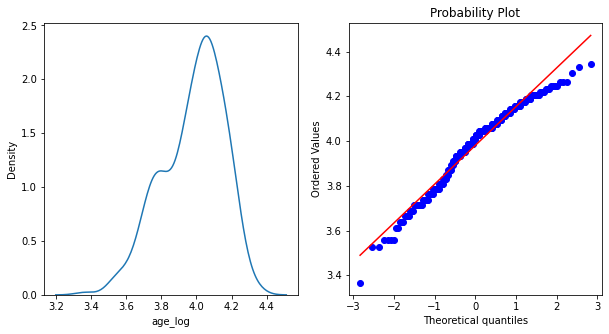

In [170]:
dt1['age_log'] = np.log(dt1['age'])
normality(dt1,'age_log')

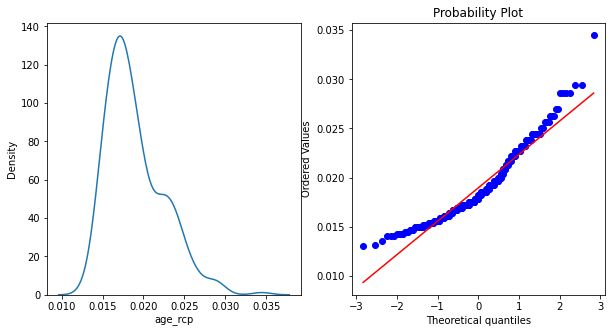

In [171]:
dt1['age_rcp'] = 1/dt1.age
normality(dt1,'age_rcp')

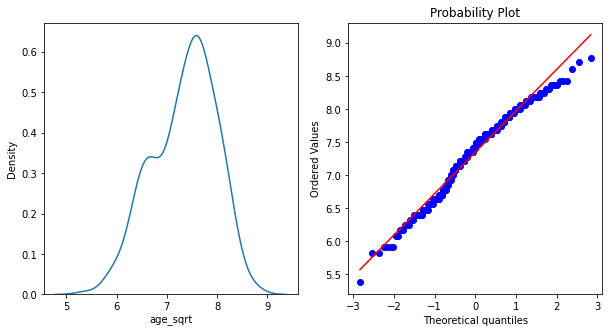

In [172]:
dt1['age_sqrt'] = np.sqrt(dt1.age)
normality(dt1,'age_sqrt')

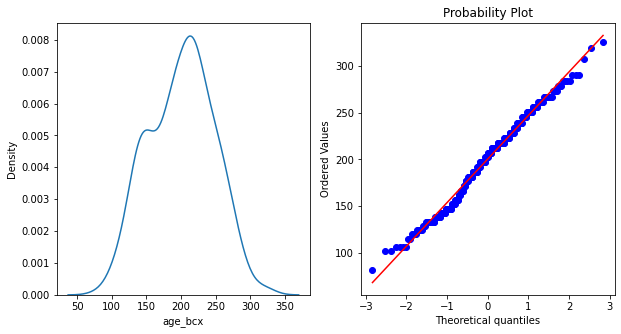

In [173]:
dt1['age_bcx'],parameters = stats.boxcox(dt1['age'])
normality(dt1,'age_bcx')

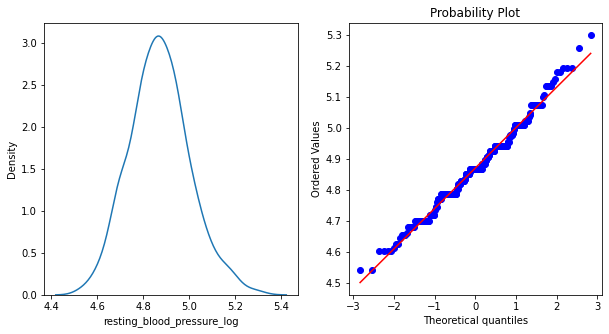

In [174]:
dt1['resting_blood_pressure_log'] = np.log(dt1['resting_blood_pressure'])
normality(dt1,'resting_blood_pressure_log')

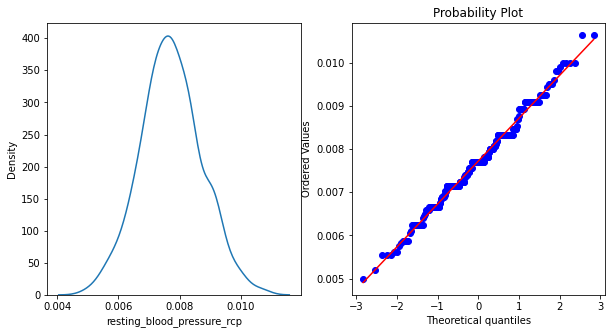

In [175]:
dt1['resting_blood_pressure_rcp'] = 1/dt1.resting_blood_pressure
normality(dt1,'resting_blood_pressure_rcp')

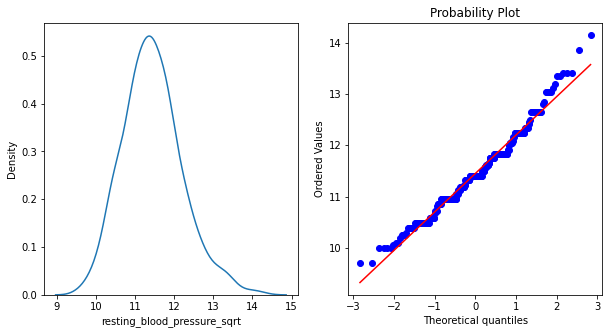

In [176]:
dt1['resting_blood_pressure_sqrt'] = np.sqrt(dt1.resting_blood_pressure)
normality(dt1,'resting_blood_pressure_sqrt')

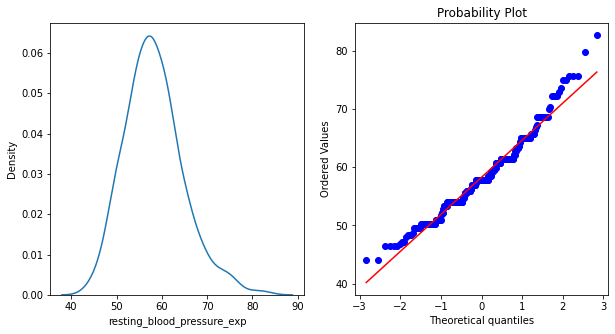

In [177]:
dt1['resting_blood_pressure_exp'] = dt1.resting_blood_pressure**(1/1.2)
normality(dt1,'resting_blood_pressure_exp')

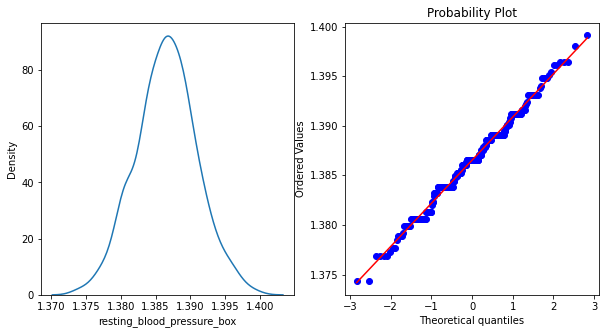

In [178]:
dt1['resting_blood_pressure_box'],parameters = stats.boxcox(dt1['resting_blood_pressure'])
normality(dt1,'resting_blood_pressure_box')

# FEATURE ENGINEERING

In [179]:
X = dt.iloc[:,:-1]
Y = dt['target']

In [180]:
X.head()

,age,gender,chest_pain_type,resting_blood_pressure,cholesterol,fasting_blood_sugar,rest_ecg,max_heart_rate_achieved,exercise_induced_angina,st_depression,st_slope,num_major_vessels,thalassemia
0,63,male,non-anginal pain,145,233,greater than 120mg/ml,normal,150,no,2.3,0,0,normal
1,37,male,atypical angina,130,250,lower than 120mg/ml,ST-T wave abnormality,187,no,3.5,0,0,fixed defect
2,41,female,typical angina,130,204,lower than 120mg/ml,normal,172,no,1.4,flat,0,fixed defect
3,56,male,typical angina,120,236,lower than 120mg/ml,ST-T wave abnormality,178,no,0.8,flat,0,fixed defect
4,57,female,0,120,354,lower than 120mg/ml,ST-T wave abnormality,163,yes,0.6,flat,0,fixed defect


In [181]:
Y.head()

0    1
1    1
2    1
3    1
4    1
Name: target, dtype: int64

# ONE HOT ENCODER

In [182]:
x = pd.get_dummies(X, drop_first=True)

In [183]:
x.head()

,age,resting_blood_pressure,cholesterol,max_heart_rate_achieved,st_depression,num_major_vessels,gender_male,chest_pain_type_0,chest_pain_type_atypical angina,chest_pain_type_non-anginal pain,chest_pain_type_typical angina,fasting_blood_sugar_lower than 120mg/ml,rest_ecg_left ventricular hypertrophy,rest_ecg_normal,exercise_induced_angina_yes,st_slope_0,st_slope_flat,st_slope_upsloping,thalassemia_0,thalassemia_fixed defect,thalassemia_normal,thalassemia_reversable defect
0,63,145,233,150,2.3,0,1,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0
1,37,130,250,187,3.5,0,1,0,1,0,0,1,0,0,0,1,0,0,0,1,0,0
2,41,130,204,172,1.4,0,0,0,0,0,1,1,0,1,0,0,1,0,0,1,0,0
3,56,120,236,178,0.8,0,1,0,0,0,1,1,0,0,0,0,1,0,0,1,0,0
4,57,120,354,163,0.6,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1,0,0


In [184]:
x.shape

(303, 22)

# FEATURE SELECTION

In [185]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

In [186]:
### Apply SelectKBest Algorithm
ordered_rank_features=SelectKBest(score_func=chi2,k=19)
ordered_feature=ordered_rank_features.fit(x,Y)

In [187]:
dtscores=pd.DataFrame(ordered_feature.scores_,columns=["Score"])
dtcolumns=pd.DataFrame(x.columns)

In [188]:
features_rank=pd.concat([dtcolumns,dtscores],axis=1)

In [189]:
features_rank.columns=['Features','Score']
features_rank

,Features,Score
0,age,23.286624
1,resting_blood_pressure,14.823925
2,cholesterol,23.936394
3,max_heart_rate_achieved,188.320472
4,st_depression,72.644253
5,num_major_vessels,66.440765
6,gender_male,7.576835
7,chest_pain_type_0,19.236364
8,chest_pain_type_atypical angina,21.670328
9,chest_pain_type_non-anginal pain,2.117219


In [190]:
features_rank.nlargest(10,'Score')

,Features,Score
3,max_heart_rate_achieved,188.320472
4,st_depression,72.644253
5,num_major_vessels,66.440765
21,thalassemia_reversable defect,43.952735
14,exercise_induced_angina_yes,38.914377
19,thalassemia_fixed defect,38.097052
16,st_slope_flat,25.001417
2,cholesterol,23.936394
0,age,23.286624
8,chest_pain_type_atypical angina,21.670328


# Feature Importance




This technique gives you a score for each feature of your data,the higher the score mor relevant it is

In [191]:
from sklearn.ensemble import ExtraTreesClassifier
#import matplotlib.pyplot as plt
model=ExtraTreesClassifier()
model.fit(x,Y)

ExtraTreesClassifier()

In [192]:
print(model.feature_importances_)

[0.0577263  0.05596338 0.05273034 0.06381572 0.0671621  0.09429386
 0.03806286 0.04677156 0.05456351 0.03507323 0.02706807 0.01606129
 0.00146946 0.03012063 0.07083689 0.0043923  0.04198517 0.04443387
 0.00034304 0.10808433 0.00704026 0.08200182]


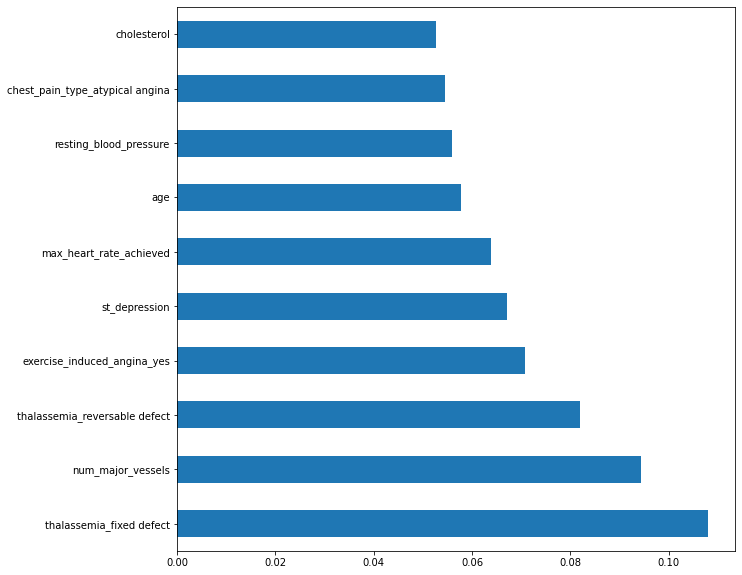

In [193]:
ranked_features=pd.Series(model.feature_importances_,index=x.columns)
ranked_features.nlargest(10).plot(kind='barh')
plt.show()

# Remove the uncorrelated features

In [194]:
threshold=0.2

In [195]:
# find and remove correlated features
def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

In [196]:
correlation(x,threshold)

{'chest_pain_type_typical angina',
 'cholesterol',
 'exercise_induced_angina_yes',
 'max_heart_rate_achieved',
 'num_major_vessels',
 'resting_blood_pressure',
 'st_depression',
 'st_slope_flat',
 'st_slope_upsloping',
 'thalassemia_fixed defect',
 'thalassemia_normal',
 'thalassemia_reversable defect'}

# INFORMATION GAIN

In [197]:
from sklearn.feature_selection import mutual_info_classif

In [198]:
mutual_info=mutual_info_classif(x,Y)

In [199]:
mutual_data=pd.Series(mutual_info,index=x.columns)
mutual_data.sort_values(ascending=False)

thalassemia_fixed defect                   0.128131
thalassemia_reversable defect              0.127324
st_slope_upsloping                         0.120883
num_major_vessels                          0.117894
st_depression                              0.105830
exercise_induced_angina_yes                0.100280
cholesterol                                0.086965
chest_pain_type_0                          0.061505
max_heart_rate_achieved                    0.055737
chest_pain_type_atypical angina            0.047678
st_slope_flat                              0.039038
rest_ecg_left ventricular hypertrophy      0.021366
fasting_blood_sugar_lower than 120mg/ml    0.017584
rest_ecg_normal                            0.008921
gender_male                                0.006027
resting_blood_pressure                     0.000000
st_slope_0                                 0.000000
chest_pain_type_typical angina             0.000000
chest_pain_type_non-anginal pain           0.000000
thalassemia_

In [232]:
selected_features = []
rfe = RFE(LogisticRegression())

rfe.fit(x.values, Y.values)

for i, feature in enumerate(x.columns.values):
    if rfe.support_[i]:
        selected_features.append(feature)

selected_X = x[selected_features]
selected_y = Y

lm = sm.Logit(selected_y, selected_X)
result = lm.fit()

print(result.summary2())

         Current function value: 0.298413
         Iterations: 35
                                    Results: Logit
Model:                     Logit                   Pseudo R-squared:        0.567     
Dependent Variable:        target                  AIC:                     202.8380  
Date:                      2021-11-26 03:27        BIC:                     243.6891  
No. Observations:          303                     Log-Likelihood:          -90.419   
Df Model:                  10                      LL-Null:                 -208.82   
Df Residuals:              292                     LLR p-value:             3.2175e-45
Converged:                 0.0000                  Scale:                   1.0000    
No. Iterations:            35.0000                                                    
--------------------------------------------------------------------------------------
                                  Coef.   Std.Err.    z    P>|z|    [0.025     0.975] 
-------------

# DATA SPLITING

In [203]:
X_train, X_test, Y_train, Y_test = train_test_split(x,Y, test_size = .2, random_state=10) #split the data

In [204]:
X_train

,age,resting_blood_pressure,cholesterol,max_heart_rate_achieved,st_depression,num_major_vessels,gender_male,chest_pain_type_0,chest_pain_type_atypical angina,chest_pain_type_non-anginal pain,chest_pain_type_typical angina,fasting_blood_sugar_lower than 120mg/ml,rest_ecg_left ventricular hypertrophy,rest_ecg_normal,exercise_induced_angina_yes,st_slope_0,st_slope_flat,st_slope_upsloping,thalassemia_0,thalassemia_fixed defect,thalassemia_normal,thalassemia_reversable defect
286,59,134,204,162,0.8,2,1,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0
102,63,140,195,179,0.0,2,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,0
242,64,145,212,132,2.0,2,1,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0
65,35,138,183,182,1.4,0,0,1,0,0,0,1,0,0,0,0,1,0,0,1,0,0
35,46,142,177,160,1.4,0,0,0,1,0,0,1,0,1,1,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156,47,130,253,179,0.0,0,1,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0
123,54,108,267,167,0.0,0,0,0,1,0,0,1,0,1,0,0,1,0,0,1,0,0
15,50,120,219,158,1.6,0,0,0,1,0,0,1,0,0,0,0,0,1,0,1,0,0
125,34,118,210,192,0.7,0,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,0


In [205]:
X_test

,age,resting_blood_pressure,cholesterol,max_heart_rate_achieved,st_depression,num_major_vessels,gender_male,chest_pain_type_0,chest_pain_type_atypical angina,chest_pain_type_non-anginal pain,chest_pain_type_typical angina,fasting_blood_sugar_lower than 120mg/ml,rest_ecg_left ventricular hypertrophy,rest_ecg_normal,exercise_induced_angina_yes,st_slope_0,st_slope_flat,st_slope_upsloping,thalassemia_0,thalassemia_fixed defect,thalassemia_normal,thalassemia_reversable defect
246,56,134,409,150,1.9,2,0,0,0,0,0,1,0,1,1,0,0,1,0,0,0,1
183,58,112,230,165,2.5,1,1,0,1,0,0,1,0,1,0,0,0,1,0,0,0,1
229,64,125,309,131,1.8,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,0,1
126,47,112,204,143,0.1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0
184,50,150,243,128,2.6,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
277,57,124,261,141,0.3,0,1,0,0,0,1,1,0,0,0,0,1,0,0,0,0,1
121,59,138,271,182,0.0,0,1,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0
187,54,124,266,109,2.2,1,1,0,0,0,0,1,0,1,1,0,0,1,0,0,0,1
301,57,130,131,115,1.2,1,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1


# LAZY PREDICT TO DECIDE BEST ALGORITHMS

In [206]:
import lazypredict
from lazypredict.Supervised import LazyClassifier

In [207]:
# Defines and builds the lazyclassifier
clf = LazyClassifier(verbose=0,ignore_warnings=True, custom_metric=None)
models_train,predictions_train = clf.fit(X_train, X_train, y_train, y_train)
models_test,predictions_test = clf.fit(X_train, X_test, y_train, y_test)

# Prints the model performance
models_train

100%|██████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<?, ?it/s]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
LGBMClassifier,1.00,1.00,1.00,1.00,0.07
LabelPropagation,1.00,1.00,1.00,1.00,0.02
XGBClassifier,1.00,1.00,1.00,1.00,1.10
RandomForestClassifier,1.00,1.00,1.00,1.00,0.20
DecisionTreeClassifier,1.00,1.00,1.00,1.00,0.02
ExtraTreeClassifier,1.00,1.00,1.00,1.00,0.01
ExtraTreesClassifier,1.00,1.00,1.00,1.00,0.14
LabelSpreading,1.00,1.00,1.00,1.00,0.02
BaggingClassifier,0.98,0.98,0.98,0.98,0.04


# DECISION TREE CLASSIFIER

In [248]:
dt_clf_gini = DecisionTreeClassifier(criterion = "gini",
                                     random_state = 100,
                                     max_depth = 5,
                                     min_samples_leaf = 5)
 
dt_clf_gini.fit(X_train, Y_train)
y_pred_gini = dt_clf_gini.predict(X_test)
 
print ("Decision Tree using Gini Index\nAccuracy is ",accuracy_score(y_test, y_pred_gini)*100 )

Decision Tree using Gini Index
Accuracy is  78.68852459016394


In [249]:
model = RandomForestClassifier(max_depth=5)
model.fit(X_train, y_train)

RandomForestClassifier(max_depth=5)

In [250]:
estimator = model.estimators_[1]
feature_names = [i for i in X_train.columns]

y_train_str = y_train.astype('str')
y_train_str[y_train_str == '0'] = 'no disease'
y_train_str[y_train_str == '1'] = 'disease'
y_train_str = y_train_str.values

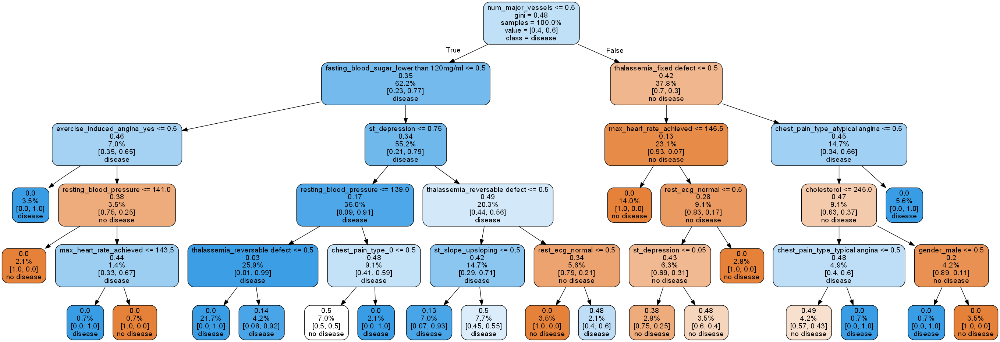

In [251]:
#code from https://towardsdatascience.com/how-to-visualize-a-decision-tree-from-a-random-forest-in-python-using-scikit-learn-38ad2d75f21c

export_graphviz(estimator, out_file='tree.dot', feature_names = feature_names,
                class_names = y_train_str,
                rounded = True, proportion = True, 
                label='root',
                precision = 2, filled = True)

from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=100'])

from IPython.display import Image
Image(filename = 'tree.png')

In [252]:
y_predict = model.predict(X_test)
y_pred_quant = model.predict_proba(X_test)[:, 1]
y_pred_bin = model.predict(X_test)

# LOGISTIC REGRESSION 

In [255]:
lr = LogisticRegression()
lr.fit(X_train,Y_train)

print(f"Accuracy: {lr.score(X_test,Y_test):0.3f}")

Accuracy: 0.836


# NAIVE BAYES

# PERFORMANCE ANALYSIS

In [213]:
confusion_matrix = confusion_matrix(y_test, y_pred_bin)
confusion_matrix

array([[29,  6],
       [ 5, 21]], dtype=int64)

In [214]:
total=sum(sum(confusion_matrix))

sensitivity = confusion_matrix[0,0]/(confusion_matrix[0,0]+confusion_matrix[1,0])
print('Sensitivity : ', sensitivity )

specificity = confusion_matrix[1,1]/(confusion_matrix[1,1]+confusion_matrix[0,1])
print('Specificity : ', specificity)

Sensitivity :  0.8529411764705882
Specificity :  0.7777777777777778


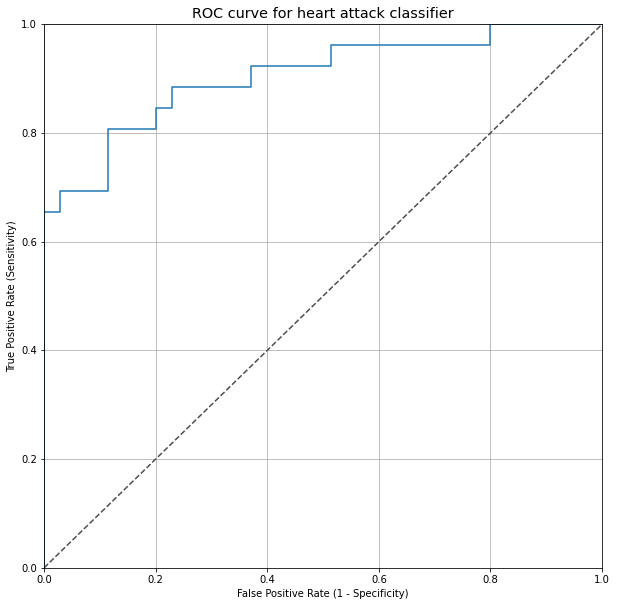

In [215]:
fpr, tpr, thresholds = roc_curve(y_test, y_pred_quant)

fig, ax = plt.subplots()
ax.plot(fpr, tpr)
ax.plot([0, 1], [0, 1], transform=ax.transAxes, ls="--", c=".3")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.rcParams['font.size'] = 12
plt.title('ROC curve for heart attack classifier')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.grid(True)

In [216]:
auc(fpr, tpr)

0.9043956043956045

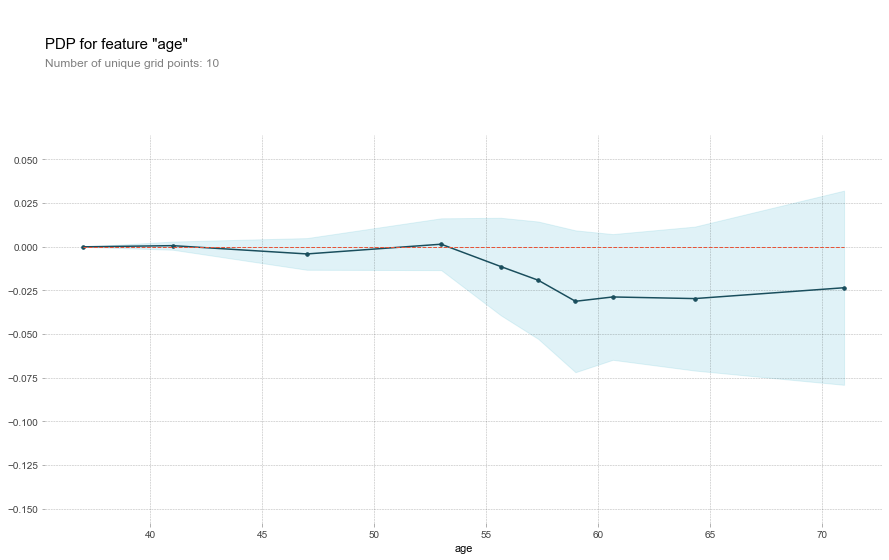

In [235]:
feat_name = 'age'
pdp_dist = pdp.pdp_isolate(model=model, dataset=X_test, model_features=base_features, feature=feat_name)

pdp.pdp_plot(pdp_dist, feat_name)
plt.show()

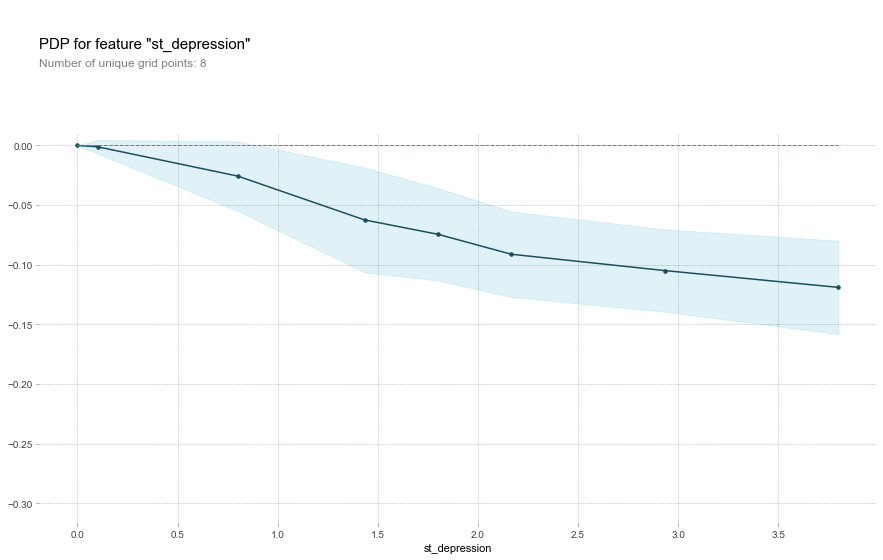

In [236]:
feat_name = 'st_depression'
pdp_dist = pdp.pdp_isolate(model=model, dataset=X_test, model_features=base_features, feature=feat_name)

pdp.pdp_plot(pdp_dist, feat_name)
plt.show()

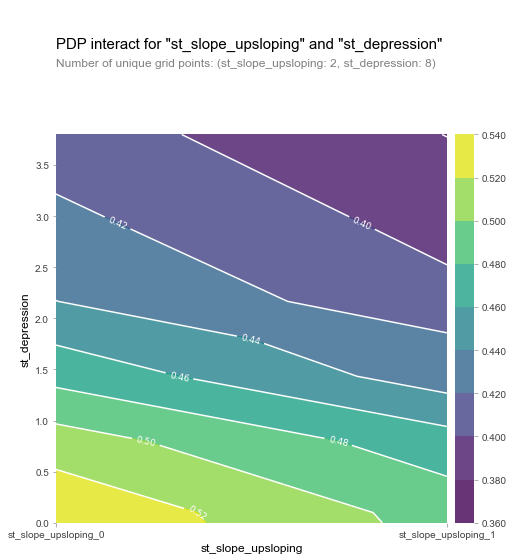

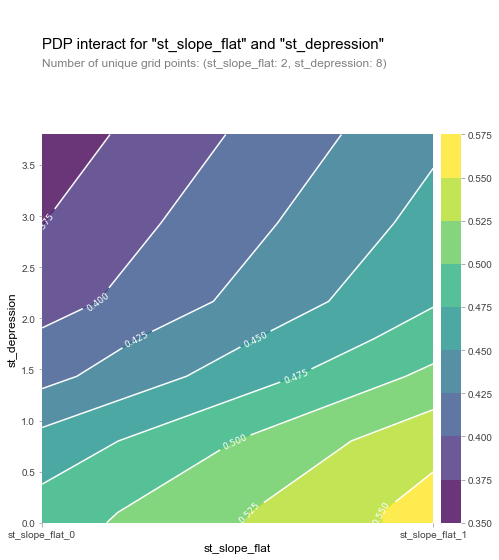

In [237]:
inter1  =  pdp.pdp_interact(model=model, dataset=X_test, model_features=base_features, features=['st_slope_upsloping', 'st_depression'])

pdp.pdp_interact_plot(pdp_interact_out=inter1, feature_names=['st_slope_upsloping', 'st_depression'], plot_type='contour')
plt.show()

inter1  =  pdp.pdp_interact(model=model, dataset=X_test, model_features=base_features, features=['st_slope_flat', 'st_depression'])

pdp.pdp_interact_plot(pdp_interact_out=inter1, feature_names=['st_slope_flat', 'st_depression'], plot_type='contour')
plt.show()

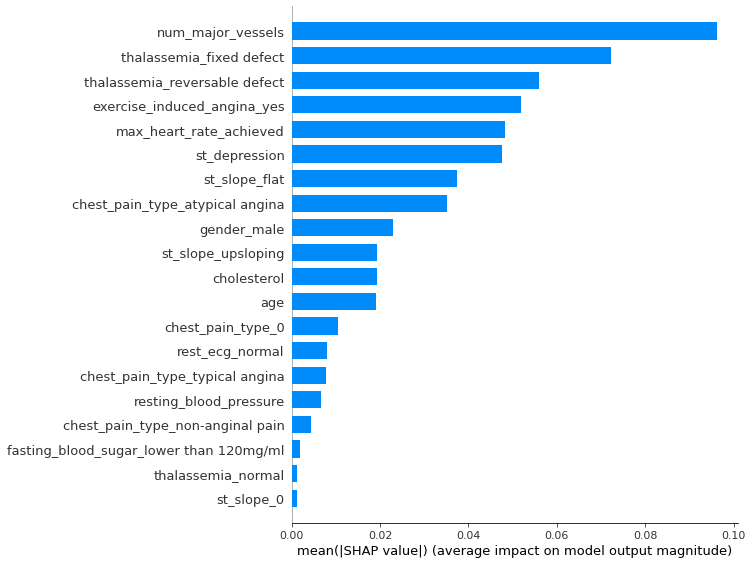

In [238]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values[1], X_test, plot_type="bar")

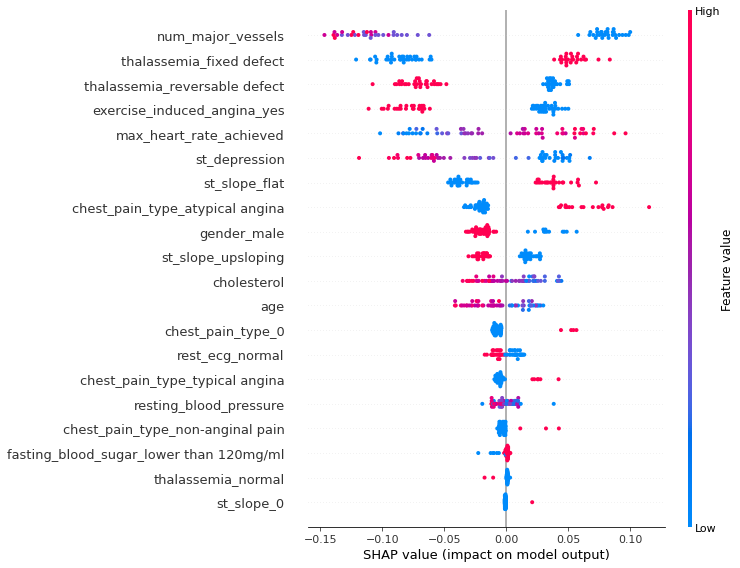

In [239]:
shap.summary_plot(shap_values[1], X_test)

In [240]:
def heart_disease_risk_factors(model, patient):

    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(patient)
    shap.initjs()
    return shap.force_plot(explainer.expected_value[1], shap_values[1], patient)

In [241]:
data_for_prediction = X_test.iloc[1,:].astype(float)
heart_disease_risk_factors(model, data_for_prediction)

In [242]:
data_for_prediction = X_test.iloc[3,:].astype(float)
heart_disease_risk_factors(model, data_for_prediction)

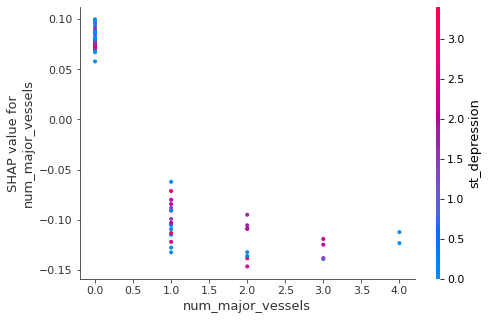

In [243]:
ax2 = fig.add_subplot(224)
shap.dependence_plot('num_major_vessels', shap_values[1], X_test, interaction_index="st_depression")

In [244]:
shap_values = explainer.shap_values(X_train.iloc[:50])
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test.iloc[:50])